In [1]:
from glob import glob
import numpy as np
from PIL import Image, ImageDraw
import cv2

In [2]:
ims = [Image.open(f) for f in glob("data/*.png")]

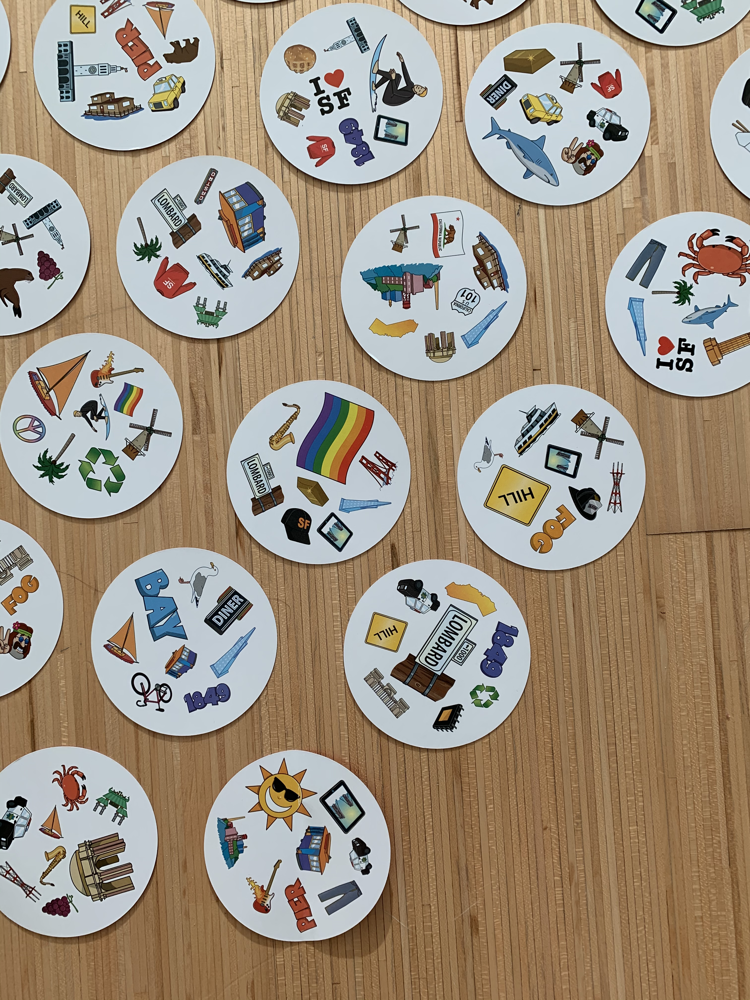

In [3]:
ims[-2]

In [4]:
# Remove backgrounds
for im in ims:
    blacks = (np.asarray(im.convert("HSV"))[..., 0] < 50).astype("uint8") * 255
    background = np.zeros(np.r_[blacks.shape] + 2, dtype="uint8")
    for x in [0, blacks.shape[1] - 1]:
        for y in [0, blacks.shape[0] - 1]:
            if blacks[y, x] != 255:
                continue
            cv2.floodFill(blacks, background, (x, y), None, flags=cv2.FLOODFILL_MASK_ONLY)
    background = background[1:-1, 1:-1] * 255
    d = ImageDraw.Draw(im)
    d.bitmap((0, 0), Image.fromarray(background), fill=(0, 0, 0))

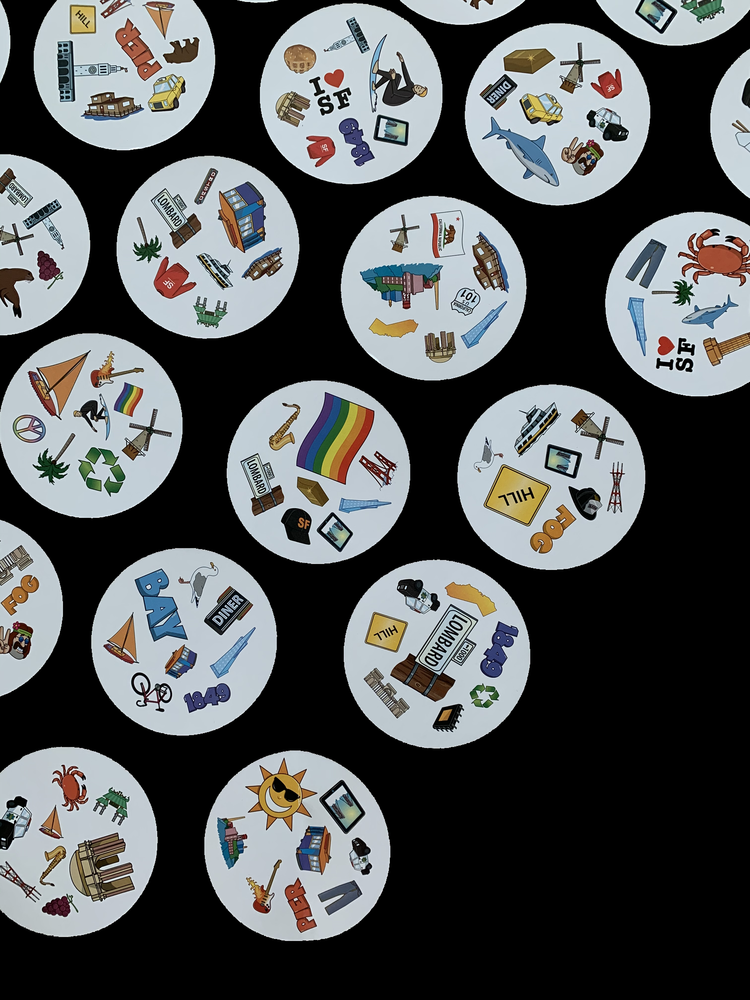

In [5]:
im = ims[-2]
im

In [6]:
feature = cv2.SIFT_create()
kp, desc = feature.detectAndCompute(np.asarray(im), None)

In [7]:
matcher = cv2.DescriptorMatcher_create(cv2.DescriptorMatcher_FLANNBASED)
knn_matches = matcher.knnMatch(desc, desc, 3)

In [8]:
#-- Filter matches using the Lowe's ratio test
ratio_thresh = 0.7
good_matches = []
for _, m, n in knn_matches:
    if m.distance < ratio_thresh * n.distance:
        good_matches.append(m)

In [38]:
lines = np.array([[
    x for ix in [m.trainIdx, m.queryIdx] for x in kp[ix].pt] 
    for m in good_matches
    if m.trainIdx < m.queryIdx
])

In [39]:
from sklearn.cluster import DBSCAN
model = DBSCAN(eps=100, min_samples=10)
model.fit(lines)

DBSCAN(eps=100, min_samples=10)

In [40]:
palette = np.arange(0, 255, dtype=np.uint8).reshape(1, 255, 1)
palette = cv2.applyColorMap(palette, cv2.COLORMAP_JET).squeeze(0)

In [41]:
im2 = im.copy()
d = ImageDraw.Draw(im2)
for i in np.unique(model.labels_):
    if i == -1:
        continue
    centroid = lines[model.labels_ == i].mean(axis=0)
    d.line(centroid.tolist(), fill=tuple(palette[np.random.choice(palette.shape[0])]), width=3)

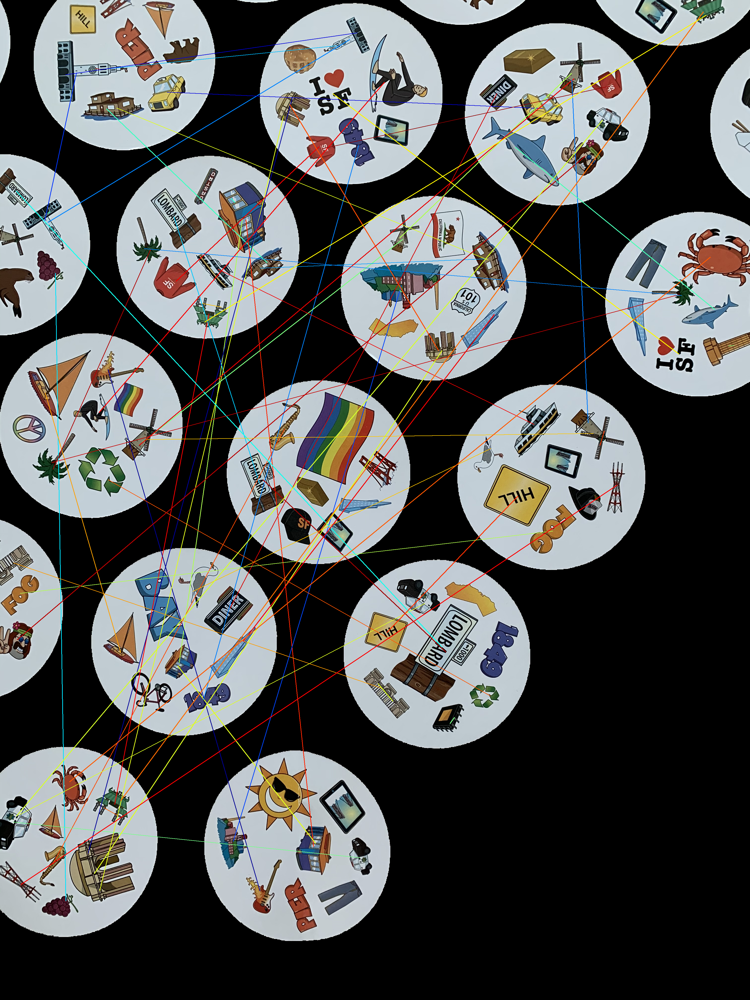

In [42]:
im2